In [1]:
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


# Оценка стоимости кварталов

In [2]:
blocks_gdf = gdf = pd.read_pickle("/Users/mvin/Code/blocksnet/examples/data/blocks2/blocks.pickle")
blocks_gdf.columns

Index(['geometry', 'residential', 'business', 'recreation', 'industrial',
       'transport', 'special', 'agriculture', 'land_use', 'share',
       ...
       'capacity_prison', 'count_prison', 'capacity_landfill',
       'count_landfill', 'capacity_plant_nursery', 'count_plant_nursery',
       'capacity_greenhouse_complex', 'count_greenhouse_complex',
       'capacity_warehouse', 'count_warehouse'],
      dtype='object', length=136)

In [3]:
# from blocksnet.analysis.morphotypes import get_strelka_morphotypes

# blocks_df = get_strelka_morphotypes(blocks_gdf)
# blocks_gdf = blocks_gdf.join(blocks_df[['morphotype']], how='left')
# blocks_df.head()

In [4]:
# cadastr_land = gpd.read_parquet('data/spb_land_cad.parquet')
cadastr_blocks = gpd.read_parquet('/Users/mvin/Code/blocksnet/examples/data/spb_bloks_price.parquet')
cadastr_blocks.head()

,cadastralDistrictsCode,readable_address,cost_value,cost_index,land_record_category_type,permitted_use_established_by_document,specified_area,geometry
0,78,"Санкт-Петербург, город Зеленогорск, Решетников...",10833260.98,5846.3362,Земли населенных пунктов,для размещения индивидуального жилого дома (ин...,1852.0,"POLYGON ((3306132.351 8453357.197, 3306131.265..."
1,78,"г.Санкт-Петербург, город Зеленогорск, Решетник...",6533139.72,5444.2831,Земли населенных пунктов,для размещения индивидуального жилого дома (ин...,1200.0,"POLYGON ((3306613.198 8453876.707, 3306609.831..."
2,78,"Санкт-Петербург, город Зеленогорск, Красавица,...",16395.97,1366.3305,Земли населенных пунктов,Для размещения объектов коммунального хозяйства,12.0,"POLYGON ((3311932.709 8453466.264, 3311927.608..."
3,78,"Санкт-Петербург, город Зеленогорск, Решетников...",8425371.37,5513.9865,Земли населенных пунктов,Для размещения индивидуального (одноквартирног...,1528.0,"POLYGON ((3306341.721 8454345.055, 3306347.49 ..."
4,78,"Санкт-Петербург, город Зеленогорск, Решетников...",11430710.60,5715.3553,Земли населенных пунктов,для размещения индивидуального жилого дома (ин...,2000.0,"POLYGON ((3306583.407 8453412.704, 3306580.412..."


In [5]:
cadastr_blocks['log_cost_index'] = np.log1p(cadastr_blocks['cost_index'])

In [6]:
# blocks_gdf['log_population'] = np.log1p(blocks_gdf['population'])

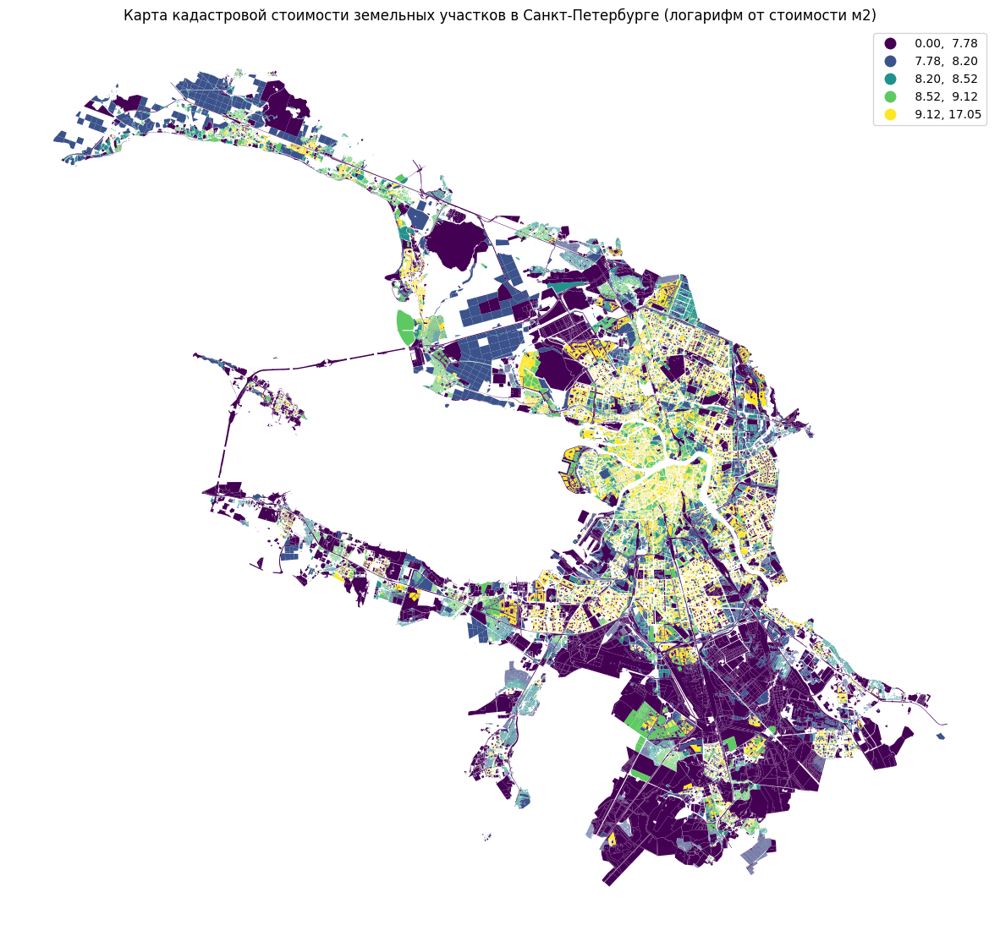

In [7]:
# Картируем лог-цену
cadastr_blocks.plot(
    column='log_cost_index',
    scheme='quantiles',
    legend=True,
    figsize=(15,15),
    cmap='viridis'
).set_axis_off()
plt.title('Карта кадастровой стоимости земельных участков в Санкт-Петербурге (логарифм от стоимости м2)')

plt.show()

In [8]:
import geopandas as gpd

# — 1. Клонируем оригиналы, чтобы не портить исходники
blocks = blocks_gdf.copy()
cad    = cadastr_blocks.copy()

# — 2. Приводим к единому CRS (он нужен для корректных площадей)
if blocks.crs != cad.crs:
    cad = cad.to_crs(blocks.crs)

# — 3. Считаем полную площадь cadastral-полигонов
cad['cad_area'] = cad.geometry.area

# — 4. Явно добавляем в blocks колонку block_id из индекса
blocks['block_id'] = blocks.index

# — 5. Пересечение кварталов и кадастра
inter = gpd.overlay(
    blocks[['block_id', 'geometry']],
    cad   [['cost_value', 'cad_area', 'geometry']],
    how='intersection'
)

# — 6. Площадь каждого куска пересечения
inter['int_area'] = inter.geometry.area

# — 7. Вклады стоимости пропорционально площади
inter['cost_contrib'] = inter['cost_value'] * inter['int_area'] / inter['cad_area']

# — 8. Суммируем для каждого квартала
block_costs = (
    inter
    .groupby('block_id', as_index=False)['cost_contrib']
    .sum()
    .rename(columns={'cost_contrib':'total_cost_value'})
)

# — 9. Мерджим обратно в blocks, заполняем пропуски нулями
blocks = blocks.merge(block_costs, on='block_id', how='left')
blocks['total_cost_value'] = blocks['total_cost_value'].fillna(0)

# — 10. При желании убираем служебный block_id (или возвращаем исходный индекс)
blocks = blocks.drop(columns=['block_id'])
blocks


/var/folders/h8/0wmx2zx90bn60jw8zc1r4qjc0000gn/T/ipykernel_9471/3193496010.py:18: UserWarning: `keep_geom_type=True` in overlay resulted in 64 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  inter = gpd.overlay(


,geometry,residential,business,recreation,industrial,transport,special,agriculture,land_use,share,...,count_prison,capacity_landfill,count_landfill,capacity_plant_nursery,count_plant_nursery,capacity_greenhouse_complex,count_greenhouse_complex,capacity_warehouse,count_warehouse,total_cost_value
0,"POLYGON ((349424.859 6631180.891, 349424.751 6...",0.000000,0.0,0.000000,0.000000,1.000000,0.0,0.000000,LandUse.TRANSPORT,1.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00
1,"POLYGON ((352083.617 6633950.146, 352240.448 6...",0.099000,0.0,0.079912,0.000000,0.401072,0.0,0.417018,LandUse.AGRICULTURE,0.417018,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.292022e+08
2,"POLYGON ((346700.642 6618453.176, 346681.107 6...",1.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,LandUse.RESIDENTIAL,1.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.859462e+08
3,"POLYGON ((347043.363 6618261.219, 347042.608 6...",0.729125,0.0,0.270875,0.000000,0.000000,0.0,0.000000,LandUse.RESIDENTIAL,0.729125,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.897886e+08
4,"POLYGON ((354879.039 6618859.116, 354845.405 6...",0.454375,0.0,0.000000,0.000000,0.144935,0.0,0.399984,LandUse.RESIDENTIAL,0.454375,...,0.0,0.0,0.0,30.0,1.0,0.0,0.0,0.0,0.0,3.733097e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9363,"POLYGON ((346635.461 6647492.048, 346473.426 6...",0.937805,0.0,0.000000,0.000000,0.062195,0.0,0.000000,LandUse.RESIDENTIAL,0.937805,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.190559e+08
9364,"POLYGON ((346361.221 6647603.446, 346328.072 6...",0.125516,0.0,0.266734,0.000000,0.607750,0.0,0.000000,LandUse.TRANSPORT,0.607750,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.747208e+08
9365,"POLYGON ((344109.285 6649134.367, 344000.209 6...",0.000000,0.0,0.763388,0.000000,0.231754,0.0,0.000000,LandUse.RECREATION,0.763388,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.718310e+08
9366,"POLYGON ((346323.488 6649497.386, 346199.573 6...",0.404385,0.0,0.000000,0.471607,0.124008,0.0,0.000000,LandUse.INDUSTRIAL,0.471607,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,150.0,1.0,2.592440e+08


In [9]:
# 1. Если CRS географический (deg), переведём в метрический (например, Меркатор)
if blocks.crs.is_geographic:
    blocks = blocks.to_crs(epsg=3857)

# 2. Считаем площадь каждого квартала в м²
blocks['site_area'] = blocks.geometry.area

# 3. Считаем цену за квадратный метр
blocks['price_per_sqm'] = blocks['total_cost_value'] / blocks['site_area']
# blocks = blocks.drop(columns=['site_area'])
# 4. (Опционально) уберём бесконечные и NaN
blocks.loc[~blocks['price_per_sqm'].replace([np.inf, -np.inf], np.nan).notna(), 'price_per_sqm'] = 0
blocks = blocks.to_crs(epsg=32636)
blocks.head()
# Результат: в blocks['price_per_sqm'] — стоимость одного квадрата метра для каждого квартала


,geometry,residential,business,recreation,industrial,transport,special,agriculture,land_use,share,...,count_landfill,capacity_plant_nursery,count_plant_nursery,capacity_greenhouse_complex,count_greenhouse_complex,capacity_warehouse,count_warehouse,total_cost_value,site_area,price_per_sqm
0,"POLYGON ((349424.859 6631180.891, 349424.751 6...",0.000000,0.0,0.000000,0.0,1.000000,0.0,0.000000,LandUse.TRANSPORT,1.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.032316,0.000000
1,"POLYGON ((352083.617 6633950.146, 352240.448 6...",0.099000,0.0,0.079912,0.0,0.401072,0.0,0.417018,LandUse.AGRICULTURE,0.417018,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.292022e+08,137101.088247,942.386203
2,"POLYGON ((346700.642 6618453.176, 346681.107 6...",1.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,LandUse.RESIDENTIAL,1.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.859462e+08,95239.084434,1952.414484
3,"POLYGON ((347043.363 6618261.219, 347042.608 6...",0.729125,0.0,0.270875,0.0,0.000000,0.0,0.000000,LandUse.RESIDENTIAL,0.729125,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.897886e+08,125919.330984,1507.223306
4,"POLYGON ((354879.039 6618859.116, 354845.405 6...",0.454375,0.0,0.000000,0.0,0.144935,0.0,0.399984,LandUse.RESIDENTIAL,0.454375,...,0.0,30.0,1.0,0.0,0.0,0.0,0.0,3.733097e+08,169860.164494,2197.747147


In [10]:
blocks['log_total_price'] = np.log1p(blocks['total_cost_value'])
blocks['log_price'] = np.log1p(blocks['price_per_sqm'])

count    9368.000000
mean       17.462873
std         5.086053
min         0.000000
25%        17.498282
50%        18.743291
75%        19.909712
max        23.881662
Name: log_total_price, dtype: float64


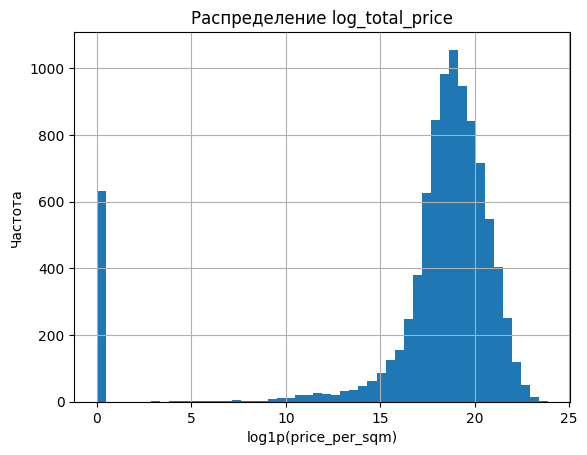

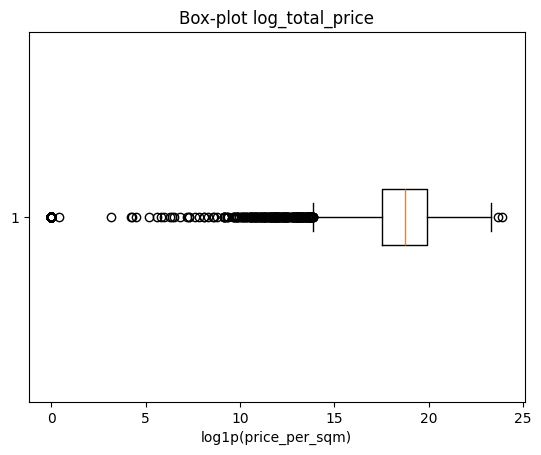

In [11]:
# Быстрая статистика
print(blocks['log_total_price'].describe())

# Гистограмма
plt.figure()
blocks['log_total_price'].hist(bins=50)
plt.xlabel('log1p(price_per_sqm)')
plt.ylabel('Частота')
plt.title('Распределение log_total_price')
plt.show()

# Box-plot
plt.figure()
plt.boxplot(blocks['log_total_price'].dropna(), vert=False)
plt.xlabel('log1p(price_per_sqm)')
plt.title('Box-plot log_total_price')
plt.show()


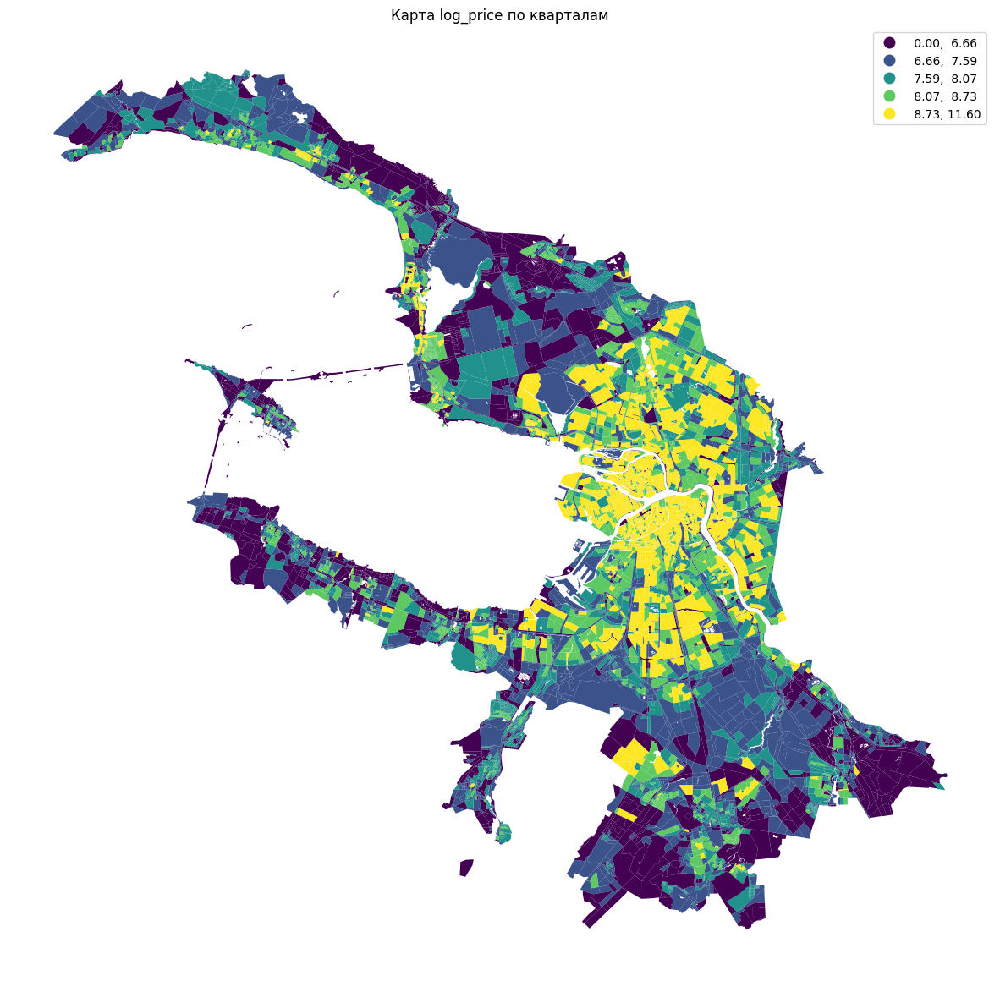

In [12]:
# Картируем лог-цену
blocks.plot(
    column='log_price',
    scheme='quantiles',
    legend=True,
    figsize=(15,15),
    cmap='viridis'
).set_axis_off()
plt.title('Карта log_price по кварталам')

plt.show()



In [13]:
# from sklearn.preprocessing import StandardScaler

# scaler = StandardScaler()
# blocks['log_std'] = scaler.fit_transform(
#     blocks[['log_price']]
# )

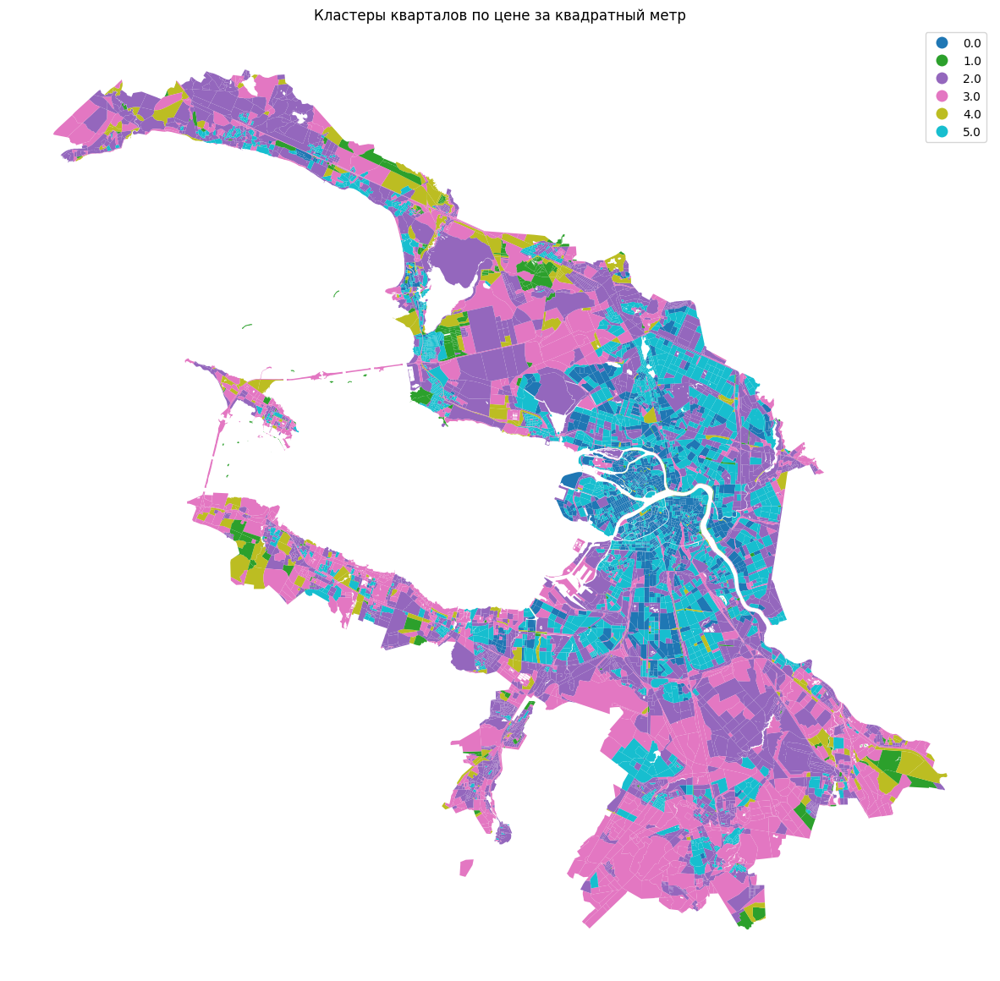

In [14]:
from sklearn.cluster import KMeans

# Берём только ненулевые и не NaN
X = blocks[['log_price']].dropna()

kmeans = KMeans(n_clusters=6, random_state=0)
blocks.loc[X.index, 'cluster'] = kmeans.fit_predict(X)

# Визуализируем
blocks.plot(
    column='cluster',
    categorical=True,
    legend=True,
    figsize=(15,15)
).set_axis_off()
plt.title('Кластеры кварталов по цене за квадратный метр')
plt.show()


In [15]:
# Собираем все имена колонок, которые начинаются на 'capacity'
cols_to_drop = [col for col in blocks.columns if col.startswith('capacity')]
blocks = blocks.drop(columns=cols_to_drop)
cols_to_drop = [col for col in blocks.columns if col.startswith('count')]

# Удаляем их сразу все
blocks = blocks.drop(columns=cols_to_drop)
blocks.columns

Index(['geometry', 'residential', 'business', 'recreation', 'industrial',
       'transport', 'special', 'agriculture', 'land_use', 'share',
       'footprint_area', 'build_floor_area', 'living_area', 'non_living_area',
       'population', 'total_cost_value', 'site_area', 'price_per_sqm',
       'log_total_price', 'log_price', 'cluster'],
      dtype='object')

In [16]:
blocks['land_use'] = (
    blocks['land_use']
    .astype(str)
    .str.replace(r'^LandUse\.', '', regex=True)
)

In [17]:
blocks

,geometry,residential,business,recreation,industrial,transport,special,agriculture,land_use,share,...,build_floor_area,living_area,non_living_area,population,total_cost_value,site_area,price_per_sqm,log_total_price,log_price,cluster
0,"POLYGON ((349424.859 6631180.891, 349424.751 6...",0.000000,0.0,0.000000,0.000000,1.000000,0.0,0.000000,TRANSPORT,1.000000,...,0.000000,0.000000,0.000000,0.0,0.000000e+00,0.032316,0.000000,0.000000,0.000000,1.0
1,"POLYGON ((352083.617 6633950.146, 352240.448 6...",0.099000,0.0,0.079912,0.000000,0.401072,0.0,0.417018,AGRICULTURE,0.417018,...,69.018103,0.000000,69.018103,0.0,1.292022e+08,137101.088247,942.386203,18.676889,6.849476,3.0
2,"POLYGON ((346700.642 6618453.176, 346681.107 6...",1.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,RESIDENTIAL,1.000000,...,6106.759644,4197.188633,1909.571011,109.0,1.859462e+08,95239.084434,1952.414484,19.040968,7.577334,2.0
3,"POLYGON ((347043.363 6618261.219, 347042.608 6...",0.729125,0.0,0.270875,0.000000,0.000000,0.0,0.000000,RESIDENTIAL,0.729125,...,4375.483259,3033.795607,1341.687653,77.0,1.897886e+08,125919.330984,1507.223306,19.061421,7.318688,2.0
4,"POLYGON ((354879.039 6618859.116, 354845.405 6...",0.454375,0.0,0.000000,0.000000,0.144935,0.0,0.399984,RESIDENTIAL,0.454375,...,31242.324144,20860.965881,10381.358263,431.0,3.733097e+08,169860.164494,2197.747147,19.737919,7.695643,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9363,"POLYGON ((346635.461 6647492.048, 346473.426 6...",0.937805,0.0,0.000000,0.000000,0.062195,0.0,0.000000,RESIDENTIAL,0.937805,...,21549.418762,9911.577637,11637.841125,199.0,2.190559e+08,16802.384600,13037.194135,19.204838,9.475638,0.0
9364,"POLYGON ((346361.221 6647603.446, 346328.072 6...",0.125516,0.0,0.266734,0.000000,0.607750,0.0,0.000000,TRANSPORT,0.607750,...,73149.192154,0.000000,73149.192154,0.0,3.747208e+08,47637.956433,7866.012468,19.741692,8.970434,5.0
9365,"POLYGON ((344109.285 6649134.367, 344000.209 6...",0.000000,0.0,0.763388,0.000000,0.231754,0.0,0.000000,RECREATION,0.763388,...,25.673922,0.000000,25.673922,0.0,1.718310e+08,64487.699525,2664.554605,18.962022,7.888167,2.0
9366,"POLYGON ((346323.488 6649497.386, 346199.573 6...",0.404385,0.0,0.000000,0.471607,0.124008,0.0,0.000000,INDUSTRIAL,0.471607,...,52737.331333,0.000000,52737.331333,0.0,2.592440e+08,42988.399080,6030.557529,19.373280,8.704761,5.0


In [18]:
blocks.to_file('blocks2.geojson', driver='GeoJSON')

## Дополнитльные метрики

In [19]:
blocks = gdf = gpd.read_file('/Users/mvin/Code/blocksnet/examples/data/blocks2/blocks2.geojson')

In [20]:
from blocksnet.analysis.indicators import calculate_density_indicators 

blocks_df = calculate_density_indicators(blocks[[
    'site_area',
    'footprint_area',
    'build_floor_area',
    'living_area'
]])
blocks_df

2025-07-01 16:19:29.669 | WARNING  | blocksnet.analysis.indicators.density.schemas:_before_validate:19 - The non_living_area is not in columns, restoring


,site_area,footprint_area,build_floor_area,living_area,non_living_area,fsi,gsi,mxi,l,osr,share_living,share_non_living
0,0.032316,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,inf,NaN,NaN
1,137101.088247,69.018103,69.018103,0.000000,69.018103,0.000503,0.000503,0.000000,1.000000,1985.451134,0.000000,1.000000
2,95239.084434,5853.863274,6106.759644,4197.188633,1909.571011,0.064120,0.061465,0.687302,1.043202,14.637095,0.716995,0.326207
3,125919.330984,4214.828165,4375.483259,3033.795607,1341.687653,0.034748,0.033472,0.693362,1.038117,27.815100,0.719791,0.318326
4,169860.164494,13392.846325,31242.324144,20860.965881,10381.358263,0.183930,0.078846,0.667715,2.332762,5.008184,1.557620,0.775142
...,...,...,...,...,...,...,...,...,...,...,...,...
9363,16802.384600,4360.962708,21549.418762,9911.577637,11637.841125,1.282521,0.259544,0.459946,4.941436,0.577344,2.272796,2.668640
9364,47637.956433,14963.573074,73149.192154,0.000000,73149.192154,1.535523,0.314110,0.000000,4.888484,0.446681,0.000000,4.888484
9365,64487.699525,25.673922,25.673922,0.000000,25.673922,0.000398,0.000398,0.000000,1.000000,2510.797791,0.000000,1.000000
9366,42988.399080,12973.889317,52737.331333,0.000000,52737.331333,1.226781,0.301800,0.000000,4.064882,0.569132,0.000000,4.064882


In [21]:
blocks.loc[:, blocks_df.columns] = blocks_df
blocks

,residential,business,recreation,industrial,transport,special,agriculture,land_use,share,footprint_area,...,log_price,cluster,geometry,fsi,gsi,mxi,l,osr,share_living,share_non_living
0,0.000000,0.0,0.000000,0.000000,1.000000,0.0,0.000000,TRANSPORT,1.000000,0.000000,...,0.000000,1.0,"POLYGON ((349424.859 6631180.891, 349424.751 6...",0.000000,0.000000,NaN,NaN,inf,NaN,NaN
1,0.099000,0.0,0.079912,0.000000,0.401072,0.0,0.417018,AGRICULTURE,0.417018,69.018103,...,6.849476,3.0,"POLYGON ((352083.617 6633950.146, 352240.448 6...",0.000503,0.000503,0.000000,1.000000,1985.451134,0.000000,1.000000
2,1.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,RESIDENTIAL,1.000000,5853.863274,...,7.577334,2.0,"POLYGON ((346700.642 6618453.176, 346681.107 6...",0.064120,0.061465,0.687302,1.043202,14.637095,0.716995,0.326207
3,0.729125,0.0,0.270875,0.000000,0.000000,0.0,0.000000,RESIDENTIAL,0.729125,4214.828165,...,7.318688,2.0,"POLYGON ((347043.363 6618261.219, 347042.608 6...",0.034748,0.033472,0.693362,1.038117,27.815100,0.719791,0.318326
4,0.454375,0.0,0.000000,0.000000,0.144935,0.0,0.399984,RESIDENTIAL,0.454375,13392.846325,...,7.695643,2.0,"POLYGON ((354879.039 6618859.116, 354845.405 6...",0.183930,0.078846,0.667715,2.332762,5.008184,1.557620,0.775142
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9363,0.937805,0.0,0.000000,0.000000,0.062195,0.0,0.000000,RESIDENTIAL,0.937805,4360.962708,...,9.475638,0.0,"POLYGON ((346635.461 6647492.048, 346473.426 6...",1.282521,0.259544,0.459946,4.941436,0.577344,2.272796,2.668640
9364,0.125516,0.0,0.266734,0.000000,0.607750,0.0,0.000000,TRANSPORT,0.607750,14963.573074,...,8.970434,5.0,"POLYGON ((346361.221 6647603.446, 346328.072 6...",1.535523,0.314110,0.000000,4.888484,0.446681,0.000000,4.888484
9365,0.000000,0.0,0.763388,0.000000,0.231754,0.0,0.000000,RECREATION,0.763388,25.673922,...,7.888167,2.0,"POLYGON ((344109.285 6649134.367, 344000.209 6...",0.000398,0.000398,0.000000,1.000000,2510.797791,0.000000,1.000000
9366,0.404385,0.0,0.000000,0.471607,0.124008,0.0,0.000000,INDUSTRIAL,0.471607,12973.889317,...,8.704761,5.0,"POLYGON ((346323.488 6649497.386, 346199.573 6...",1.226781,0.301800,0.000000,4.064882,0.569132,0.000000,4.064882


In [22]:
from blocksnet.analysis.morphotypes import get_strelka_morphotypes


blocks_df = get_strelka_morphotypes(blocks)
blocks_df

,l,fsi,mxi,morphotype
0,0.000000,0.000000,0.000000,NaN
1,1.000000,0.000503,0.000000,low-rise non-residential
2,1.043202,0.064120,0.687302,individual residential
3,1.038117,0.034748,0.693362,individual residential
4,2.332762,0.183930,0.667715,low-rise model
...,...,...,...,...
9363,4.941436,1.282521,0.459946,mid-rise
9364,4.888484,1.535523,0.000000,mid-rise non-residential
9365,1.000000,0.000398,0.000000,low-rise non-residential
9366,4.064882,1.226781,0.000000,mid-rise non-residential


In [23]:
blocks.loc[:, blocks_df.columns] = blocks_df
blocks

,residential,business,recreation,industrial,transport,special,agriculture,land_use,share,footprint_area,...,cluster,geometry,fsi,gsi,mxi,l,osr,share_living,share_non_living,morphotype
0,0.000000,0.0,0.000000,0.000000,1.000000,0.0,0.000000,TRANSPORT,1.000000,0.000000,...,1.0,"POLYGON ((349424.859 6631180.891, 349424.751 6...",0.000000,0.000000,0.000000,0.000000,inf,NaN,NaN,NaN
1,0.099000,0.0,0.079912,0.000000,0.401072,0.0,0.417018,AGRICULTURE,0.417018,69.018103,...,3.0,"POLYGON ((352083.617 6633950.146, 352240.448 6...",0.000503,0.000503,0.000000,1.000000,1985.451134,0.000000,1.000000,low-rise non-residential
2,1.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,RESIDENTIAL,1.000000,5853.863274,...,2.0,"POLYGON ((346700.642 6618453.176, 346681.107 6...",0.064120,0.061465,0.687302,1.043202,14.637095,0.716995,0.326207,individual residential
3,0.729125,0.0,0.270875,0.000000,0.000000,0.0,0.000000,RESIDENTIAL,0.729125,4214.828165,...,2.0,"POLYGON ((347043.363 6618261.219, 347042.608 6...",0.034748,0.033472,0.693362,1.038117,27.815100,0.719791,0.318326,individual residential
4,0.454375,0.0,0.000000,0.000000,0.144935,0.0,0.399984,RESIDENTIAL,0.454375,13392.846325,...,2.0,"POLYGON ((354879.039 6618859.116, 354845.405 6...",0.183930,0.078846,0.667715,2.332762,5.008184,1.557620,0.775142,low-rise model
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9363,0.937805,0.0,0.000000,0.000000,0.062195,0.0,0.000000,RESIDENTIAL,0.937805,4360.962708,...,0.0,"POLYGON ((346635.461 6647492.048, 346473.426 6...",1.282521,0.259544,0.459946,4.941436,0.577344,2.272796,2.668640,mid-rise
9364,0.125516,0.0,0.266734,0.000000,0.607750,0.0,0.000000,TRANSPORT,0.607750,14963.573074,...,5.0,"POLYGON ((346361.221 6647603.446, 346328.072 6...",1.535523,0.314110,0.000000,4.888484,0.446681,0.000000,4.888484,mid-rise non-residential
9365,0.000000,0.0,0.763388,0.000000,0.231754,0.0,0.000000,RECREATION,0.763388,25.673922,...,2.0,"POLYGON ((344109.285 6649134.367, 344000.209 6...",0.000398,0.000398,0.000000,1.000000,2510.797791,0.000000,1.000000,low-rise non-residential
9366,0.404385,0.0,0.000000,0.471607,0.124008,0.0,0.000000,INDUSTRIAL,0.471607,12973.889317,...,5.0,"POLYGON ((346323.488 6649497.386, 346199.573 6...",1.226781,0.301800,0.000000,4.064882,0.569132,0.000000,4.064882,mid-rise non-residential


In [24]:
from blocksnet.relations import generate_adjacency_graph

adjacency_graph = generate_adjacency_graph(blocks)

2025-07-01 16:19:31.499 | INFO     | blocksnet.relations.adjacency.core:_generate_adjacency_nodes:10 - Generating nodes
2025-07-01 16:19:31.501 | INFO     | blocksnet.relations.adjacency.core:_generate_adjacency_edges:15 - Generating edges
2025-07-01 16:19:32.749 | SUCCESS  | blocksnet.relations.adjacency.core:generate_adjacency_graph:38 - Adjacency graph successfully generated: 9368 nodes, 27879 edges


In [25]:
import pandas as pd

accessibility_matrix = pd.read_pickle('/Users/mvin/Code/blocksnet/examples/data/blocks2/acc_mx.pickle')
accessibility_matrix.head()

/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/pandas/io/formats/format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,0,1,2,3,4,5,6,7,8,9,...,9358,9359,9360,9361,9362,9363,9364,9365,9366,9367
0,0.0000,58.15625,74.187500,76.937500,66.8125,80.5000,92.18750,66.56250,65.68750,106.8750,...,70.0000,72.1875,72.0000,73.3125,73.2500,74.0000,75.5000,83.1875,75.0000,73.2500
1,56.2500,0.00000,99.687500,102.375000,88.1250,76.1250,113.43750,89.43750,88.56250,96.3125,...,65.6250,67.7500,67.6875,69.0000,68.8750,69.6875,71.1875,78.8125,70.6875,68.8750
2,74.5000,96.50000,0.000000,5.347656,74.0000,118.8125,92.06250,64.43750,63.56250,134.5000,...,108.3125,110.4375,110.3750,111.6875,111.5625,112.3750,113.8125,121.5000,113.3750,111.5625
3,77.2500,99.25000,5.347656,0.000000,76.7500,121.5625,90.12500,67.18750,66.31250,137.2500,...,111.0625,113.1875,113.0625,114.3750,114.3125,115.0625,116.5625,124.2500,116.1250,114.3125
4,70.1875,90.56250,82.375000,85.125000,0.0000,110.5000,35.53125,45.15625,44.28125,89.8750,...,100.0000,102.1250,102.0000,103.3125,103.2500,104.0000,105.5000,113.1875,105.0000,103.2500


In [26]:
from blocksnet.analysis.accessibility import area_accessibility

area_acc_df = area_accessibility(accessibility_matrix, blocks)
area_acc_df

,area_accessibility
0,114.184718
1,113.847998
2,145.884534
3,148.543184
4,132.691062
...,...
9363,92.742199
9364,94.557197
9365,100.500833
9366,92.488100


In [27]:
blocks= blocks.join(area_acc_df)


In [28]:
blocks

,residential,business,recreation,industrial,transport,special,agriculture,land_use,share,footprint_area,...,geometry,fsi,gsi,mxi,l,osr,share_living,share_non_living,morphotype,area_accessibility
0,0.000000,0.0,0.000000,0.000000,1.000000,0.0,0.000000,TRANSPORT,1.000000,0.000000,...,"POLYGON ((349424.859 6631180.891, 349424.751 6...",0.000000,0.000000,0.000000,0.000000,inf,NaN,NaN,NaN,114.184718
1,0.099000,0.0,0.079912,0.000000,0.401072,0.0,0.417018,AGRICULTURE,0.417018,69.018103,...,"POLYGON ((352083.617 6633950.146, 352240.448 6...",0.000503,0.000503,0.000000,1.000000,1985.451134,0.000000,1.000000,low-rise non-residential,113.847998
2,1.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,RESIDENTIAL,1.000000,5853.863274,...,"POLYGON ((346700.642 6618453.176, 346681.107 6...",0.064120,0.061465,0.687302,1.043202,14.637095,0.716995,0.326207,individual residential,145.884534
3,0.729125,0.0,0.270875,0.000000,0.000000,0.0,0.000000,RESIDENTIAL,0.729125,4214.828165,...,"POLYGON ((347043.363 6618261.219, 347042.608 6...",0.034748,0.033472,0.693362,1.038117,27.815100,0.719791,0.318326,individual residential,148.543184
4,0.454375,0.0,0.000000,0.000000,0.144935,0.0,0.399984,RESIDENTIAL,0.454375,13392.846325,...,"POLYGON ((354879.039 6618859.116, 354845.405 6...",0.183930,0.078846,0.667715,2.332762,5.008184,1.557620,0.775142,low-rise model,132.691062
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9363,0.937805,0.0,0.000000,0.000000,0.062195,0.0,0.000000,RESIDENTIAL,0.937805,4360.962708,...,"POLYGON ((346635.461 6647492.048, 346473.426 6...",1.282521,0.259544,0.459946,4.941436,0.577344,2.272796,2.668640,mid-rise,92.742199
9364,0.125516,0.0,0.266734,0.000000,0.607750,0.0,0.000000,TRANSPORT,0.607750,14963.573074,...,"POLYGON ((346361.221 6647603.446, 346328.072 6...",1.535523,0.314110,0.000000,4.888484,0.446681,0.000000,4.888484,mid-rise non-residential,94.557197
9365,0.000000,0.0,0.763388,0.000000,0.231754,0.0,0.000000,RECREATION,0.763388,25.673922,...,"POLYGON ((344109.285 6649134.367, 344000.209 6...",0.000398,0.000398,0.000000,1.000000,2510.797791,0.000000,1.000000,low-rise non-residential,100.500833
9366,0.404385,0.0,0.000000,0.471607,0.124008,0.0,0.000000,INDUSTRIAL,0.471607,12973.889317,...,"POLYGON ((346323.488 6649497.386, 346199.573 6...",1.226781,0.301800,0.000000,4.064882,0.569132,0.000000,4.064882,mid-rise non-residential,92.488100


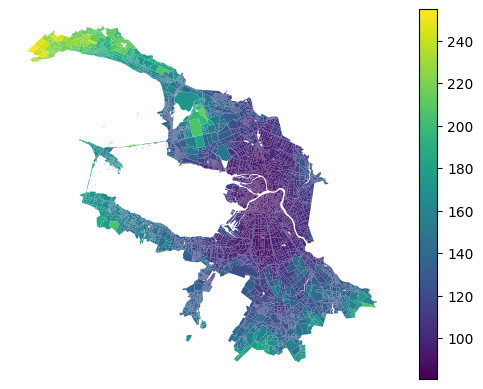

In [29]:
blocks.plot(column='area_accessibility', legend=True).set_axis_off()

In [30]:
blocks = blocks.drop(columns='cluster')

In [31]:
# 1. Выведем все dtypes
print(blocks.dtypes)

# 2. Отберём «чисто» категориальные (object / category)
cat_cols = blocks.select_dtypes(include=['object','category']).columns.tolist()
print("Категориальные по dtype:", cat_cols)

# 3. Часто к категориальным относят и числовые колонки с малым числом уникальных значений.
#    Например, если уникальных значений меньше 10:
low_cardinality = [
    col for col in blocks.select_dtypes(include=['int64','float64']).columns
    if blocks[col].nunique() < 10
]
print("Возможно категориальные по низкой кардинальности:", low_cardinality)


residential            float64
business               float64
recreation             float64
industrial             float64
transport              float64
special                float64
agriculture            float64
land_use                object
share                  float64
footprint_area         float64
build_floor_area       float64
living_area            float64
non_living_area        float64
population             float64
total_cost_value       float64
site_area              float64
price_per_sqm          float64
log_total_price        float64
log_price              float64
geometry              geometry
fsi                    float64
gsi                    float64
mxi                    float64
l                      float64
osr                    float64
share_living           float64
share_non_living       float64
morphotype              object
area_accessibility     float64
dtype: object
Категориальные по dtype: ['land_use', 'morphotype']
Возможно категориальные по низкой к

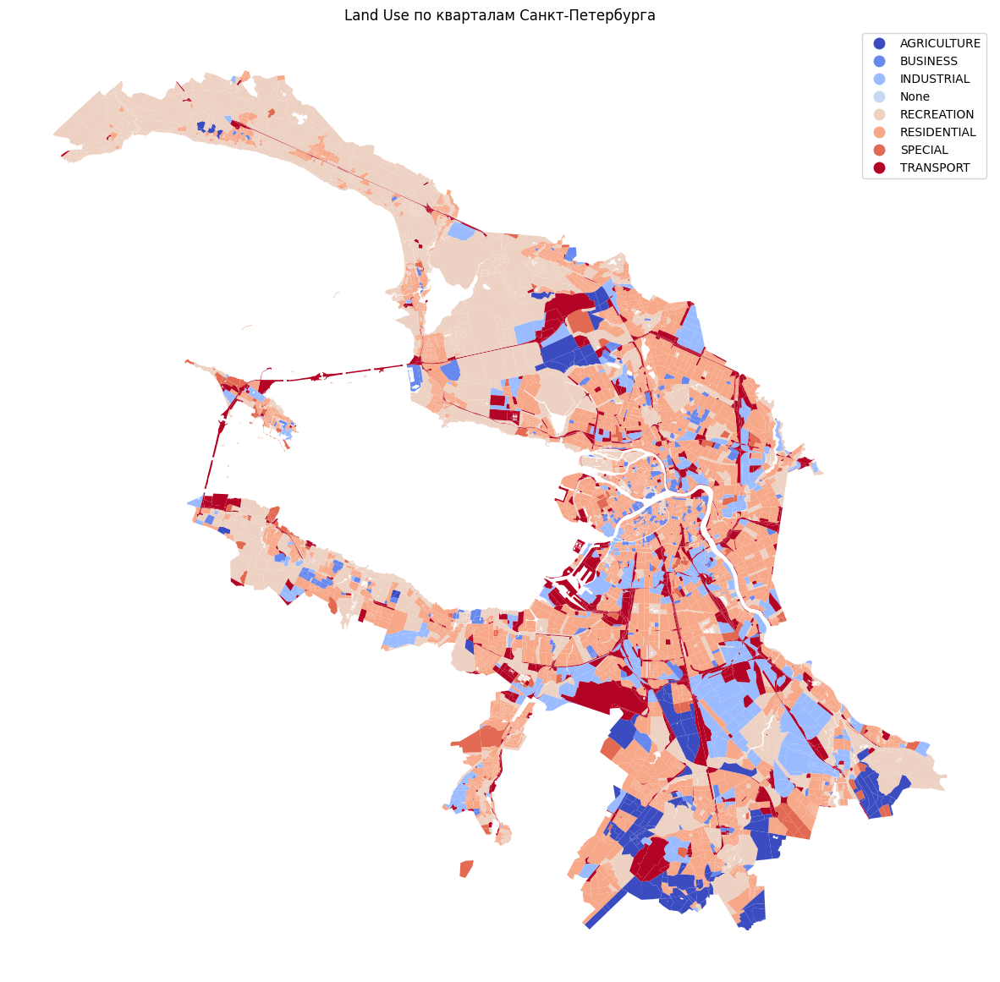

In [32]:
# Картируем лог-цену
blocks.plot(
    column='land_use',
    legend=True,
    figsize=(15,15),
    cmap='coolwarm'
).set_axis_off()
plt.title('Land Use по кварталам Санкт-Петербурга')

plt.show()

In [33]:
import pandas as pd

# 1. Отбираем числовые столбцы и фильтруем
num = blocks.select_dtypes(include=['number'])
num = num[num['log_price'] > 1]

# 2. Считаем count + статистики
agg_stats = num.agg(['count', 'min', 'max', 'mean', 'median', 'std']).T

# 3. Переименовываем столбцы
agg_stats.index.name = 'Variable'
agg_stats = agg_stats.rename(columns={
    'count':  'Count',
    'min':    'Min',
    'max':    'Max',
    'mean':   'Mean',
    'median': 'Median',
    'std':    'SD'
})

# 4. Приводим Count к int
agg_stats['Count'] = agg_stats['Count'].astype(int)

# 5. Округляем остальные метрики
for col in ['Min','Max','Mean','Median','SD']:
    agg_stats[col] = agg_stats[col].round(2)

# 6. Настраиваем глобальный формат для float
pd.options.display.float_format = '{:,.2f}'.format

# 7. Показываем результат
agg_stats


/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


,Count,Min,Max,Mean,Median,SD
Variable,,,,,,
residential,8703,0.00,1.00,0.51,0.68,0.43
business,8703,0.00,1.00,0.03,0.00,0.15
recreation,8703,0.00,1.00,0.18,0.00,0.33
industrial,8703,0.00,1.00,0.05,0.00,0.19
transport,8703,0.00,1.00,0.18,0.07,0.28
special,8703,0.00,1.00,0.01,0.00,0.10
agriculture,8703,0.00,1.00,0.01,0.00,0.11
share,8692,0.00,1.00,0.85,0.91,0.16
footprint_area,8703,0.00,"818,787.73","11,961.95","3,202.12","25,274.92"


In [34]:
blocks_default = blocks.copy()

In [35]:
# blocks = blocks_default[blocks_default['land_use'] == 'RESIDENTIAL'].copy()

In [36]:
blocks = blocks[blocks['log_total_price'] > 0].copy()
blocks = blocks.reset_index(drop=True)
blocks

,residential,business,recreation,industrial,transport,special,agriculture,land_use,share,footprint_area,...,geometry,fsi,gsi,mxi,l,osr,share_living,share_non_living,morphotype,area_accessibility
0,0.10,0.00,0.08,0.00,0.40,0.00,0.42,AGRICULTURE,0.42,69.02,...,"POLYGON ((352083.617 6633950.146, 352240.448 6...",0.00,0.00,0.00,1.00,"1,985.45",0.00,1.00,low-rise non-residential,113.85
1,1.00,0.00,0.00,0.00,0.00,0.00,0.00,RESIDENTIAL,1.00,"5,853.86",...,"POLYGON ((346700.642 6618453.176, 346681.107 6...",0.06,0.06,0.69,1.04,14.64,0.72,0.33,individual residential,145.88
2,0.73,0.00,0.27,0.00,0.00,0.00,0.00,RESIDENTIAL,0.73,"4,214.83",...,"POLYGON ((347043.363 6618261.219, 347042.608 6...",0.03,0.03,0.69,1.04,27.82,0.72,0.32,individual residential,148.54
3,0.45,0.00,0.00,0.00,0.14,0.00,0.40,RESIDENTIAL,0.45,"13,392.85",...,"POLYGON ((354879.039 6618859.116, 354845.405 6...",0.18,0.08,0.67,2.33,5.01,1.56,0.78,low-rise model,132.69
4,0.11,0.00,0.00,0.77,0.06,0.00,0.00,INDUSTRIAL,0.77,"1,632.04",...,"POLYGON ((347215.933 6646341.789, 347245.429 6...",1.00,0.25,0.00,4.00,0.75,0.00,4.00,mid-rise non-residential,99.16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8753,0.94,0.00,0.00,0.00,0.06,0.00,0.00,RESIDENTIAL,0.94,"4,360.96",...,"POLYGON ((346635.461 6647492.048, 346473.426 6...",1.28,0.26,0.46,4.94,0.58,2.27,2.67,mid-rise,92.74
8754,0.13,0.00,0.27,0.00,0.61,0.00,0.00,TRANSPORT,0.61,"14,963.57",...,"POLYGON ((346361.221 6647603.446, 346328.072 6...",1.54,0.31,0.00,4.89,0.45,0.00,4.89,mid-rise non-residential,94.56
8755,0.00,0.00,0.76,0.00,0.23,0.00,0.00,RECREATION,0.76,25.67,...,"POLYGON ((344109.285 6649134.367, 344000.209 6...",0.00,0.00,0.00,1.00,"2,510.80",0.00,1.00,low-rise non-residential,100.50
8756,0.40,0.00,0.00,0.47,0.12,0.00,0.00,INDUSTRIAL,0.47,"12,973.89",...,"POLYGON ((346323.488 6649497.386, 346199.573 6...",1.23,0.30,0.00,4.06,0.57,0.00,4.06,mid-rise non-residential,92.49


In [37]:
list(blocks.columns)

['residential',
 'business',
 'recreation',
 'industrial',
 'transport',
 'special',
 'agriculture',
 'land_use',
 'share',
 'footprint_area',
 'build_floor_area',
 'living_area',
 'non_living_area',
 'population',
 'total_cost_value',
 'site_area',
 'price_per_sqm',
 'log_total_price',
 'log_price',
 'geometry',
 'fsi',
 'gsi',
 'mxi',
 'l',
 'osr',
 'share_living',
 'share_non_living',
 'morphotype',
 'area_accessibility']

In [38]:
blocks['id'] = blocks.index
blocks2 = blocks[['id', 'geometry']].copy()
blocks2.explore()

/var/folders/h8/0wmx2zx90bn60jw8zc1r4qjc0000gn/T/ipykernel_9471/3918900748.py:8: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w1 = libpysal.weights.Queen.from_dataframe(blocks_default)
/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/libpysal/weights/contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 224 disconnected components.
 There are 193 islands with ids: 145, 365, 366, 495, 929, 1244, 1405, 1420, 1440, 1894, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 2566, 2597, 3272, 3273, 3274, 3275, 3276, 3277, 3278, 3292, 3293, 3294, 3295, 3296, 3297, 3298, 3322, 3323, 3324, 3325, 3326, 3327, 3328, 3329, 3330, 3331, 3332, 3340, 3341, 3342, 3358, 3359, 3360, 3361, 3362, 3363, 3364, 3365, 3366, 3367, 3368, 3406, 3407, 3408, 3409, 3410, 3411, 3417, 3439, 3504, 3763, 3774, 3775, 3883, 3891, 3893, 4027, 

('WARNING: ', 145, ' is an island (no neighbors)')
('WARNING: ', 365, ' is an island (no neighbors)')
('WARNING: ', 366, ' is an island (no neighbors)')
('WARNING: ', 495, ' is an island (no neighbors)')
('WARNING: ', 929, ' is an island (no neighbors)')
('WARNING: ', 1244, ' is an island (no neighbors)')
('WARNING: ', 1405, ' is an island (no neighbors)')
('WARNING: ', 1420, ' is an island (no neighbors)')
('WARNING: ', 1440, ' is an island (no neighbors)')
('WARNING: ', 1894, ' is an island (no neighbors)')
('WARNING: ', 1934, ' is an island (no neighbors)')
('WARNING: ', 1935, ' is an island (no neighbors)')
('WARNING: ', 1936, ' is an island (no neighbors)')
('WARNING: ', 1937, ' is an island (no neighbors)')
('WARNING: ', 1938, ' is an island (no neighbors)')
('WARNING: ', 1939, ' is an island (no neighbors)')
('WARNING: ', 1940, ' is an island (no neighbors)')
('WARNING: ', 1941, ' is an island (no neighbors)')
('WARNING: ', 1942, ' is an island (no neighbors)')
('WARNING: ', 194

/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/esda/moran.py:1350: RuntimeWarning: invalid value encountered in divide
  self.z_sim = (self.Is - self.EI_sim) / self.seI_sim


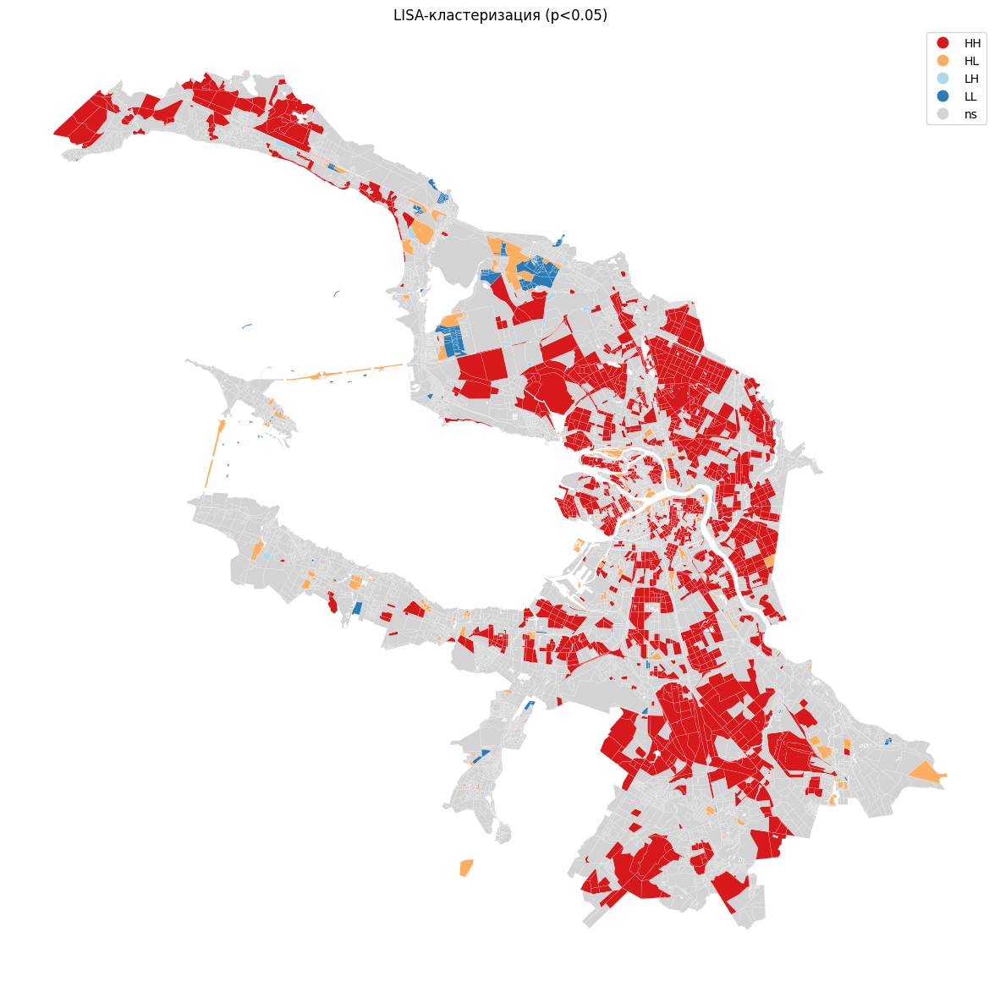

In [40]:
import libpysal
from esda.moran import Moran, Moran_Local
import matplotlib.pyplot as plt
from splot.esda import lisa_cluster

# 1) Подготовка: spatial weights
# Если у вас уже есть w1 (Rook или Queen), используем его, иначе:
w1 = libpysal.weights.Queen.from_dataframe(blocks_default)
# или: w1 = libpysal.weights.Rook.from_dataframe(blocks)
w1.transform = 'r'   # row-standardization

# 2) Извлекаем вектор переменной
y = blocks_default['log_total_price'].values

# 3) Глобальный индекс Морена
moran_global = Moran(y, w1)
print("Global Moran’s I:",     round(moran_global.I,3))
print("p-value (normal):",     round(moran_global.p_norm,3))
print("z-score (normal):",     round(moran_global.z_norm,3))
print("p-value (permut.):",    round(moran_global.p_sim,3))
print("z-score (permut.):",    round(moran_global.z_sim,3))

# 4) Локальный индекс Морена
lisa = Moran_Local(y, w1)

# 5) Добавляем результаты в GeoDataFrame
blocks_default['lisa_I']   = lisa.Is          # локальные значения I
blocks_default['lisa_p']   = lisa.p_sim       # p-values по перестановкам
blocks_default['lisa_q']   = lisa.q           # квадранты (1=HH, 2=LH, 3=LL, 4=HL)
blocks_default['lisa_sig'] = lisa.p_sim < 0.05

# 6) Визуализация LISA-кластеров
fig, ax = plt.subplots(1, figsize=(15, 15))
# splot умеет сам раскрасить по четырём кластерам
lisa_cluster(lisa, blocks_default, p=0.05, ax=ax)
ax.set_title("LISA-кластеризация (p<0.05)")
ax.axis('off')
plt.show()


# CatBoost

/var/folders/h8/0wmx2zx90bn60jw8zc1r4qjc0000gn/T/ipykernel_8098/2392573511.py:21: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w1 = Queen.from_dataframe(blocks)      # w1.weights — все 1
/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/libpysal/weights/contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 265 disconnected components.
 There are 66 islands with ids: 212, 1144, 1316, 1388, 1392, 1409, 1480, 1541, 1659, 1868, 1886, 2063, 2071, 2093, 2096, 2098, 2180, 2283, 2337, 2338, 2339, 2340, 2341, 2344, 2388, 2550, 2571, 2660, 2709, 2786, 3092, 3219, 3371, 3373, 3376, 3382, 3570, 3625, 3879, 3880, 3917, 3959, 4054, 4108, 4146, 4163, 4202, 4300, 4301, 4312, 4343, 4427, 4445, 4446, 4450, 4627, 4636, 4703, 4745, 4748, 4792, 4810, 4812, 4821, 4860, 4907.
  W.__init__(self, neighbors, ids=ids, **kw)
/Users/mvin/Code/blocksnet/.venv/l

('WARNING: ', 212, ' is an island (no neighbors)')
('WARNING: ', 1144, ' is an island (no neighbors)')
('WARNING: ', 1316, ' is an island (no neighbors)')
('WARNING: ', 1388, ' is an island (no neighbors)')
('WARNING: ', 1392, ' is an island (no neighbors)')
('WARNING: ', 1409, ' is an island (no neighbors)')
('WARNING: ', 1480, ' is an island (no neighbors)')
('WARNING: ', 1541, ' is an island (no neighbors)')
('WARNING: ', 1659, ' is an island (no neighbors)')
('WARNING: ', 1868, ' is an island (no neighbors)')
('WARNING: ', 1886, ' is an island (no neighbors)')
('WARNING: ', 2063, ' is an island (no neighbors)')
('WARNING: ', 2071, ' is an island (no neighbors)')
('WARNING: ', 2093, ' is an island (no neighbors)')
('WARNING: ', 2096, ' is an island (no neighbors)')
('WARNING: ', 2098, ' is an island (no neighbors)')
('WARNING: ', 2180, ' is an island (no neighbors)')
('WARNING: ', 2283, ' is an island (no neighbors)')
('WARNING: ', 2337, ' is an island (no neighbors)')
('WARNING: ',

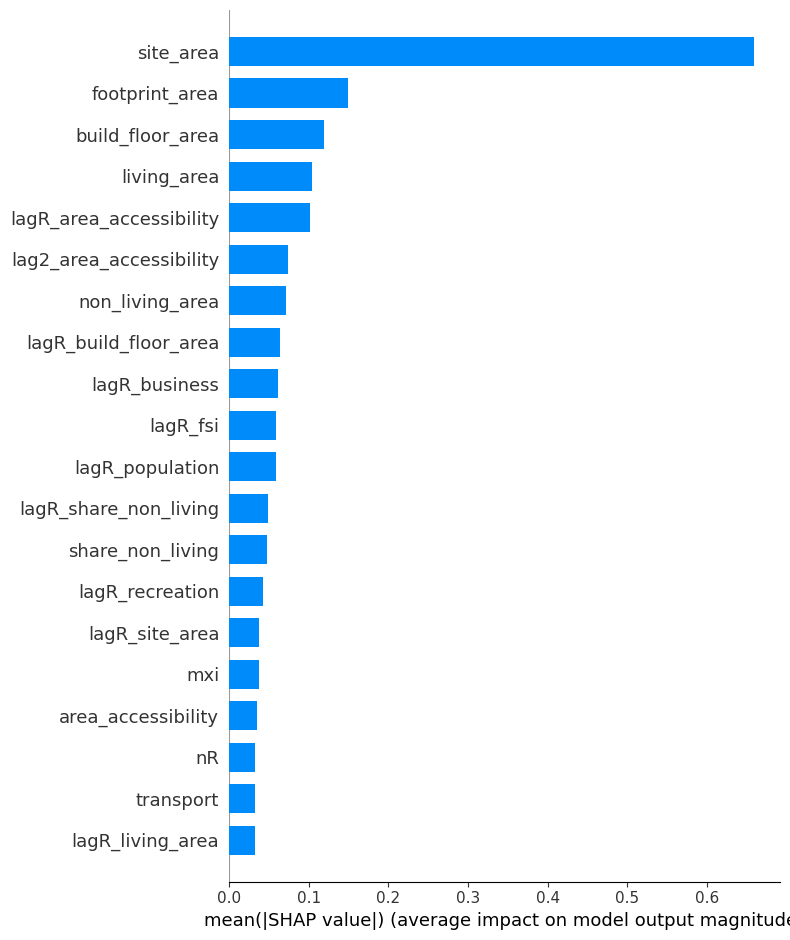

<Figure size 640x480 with 0 Axes>

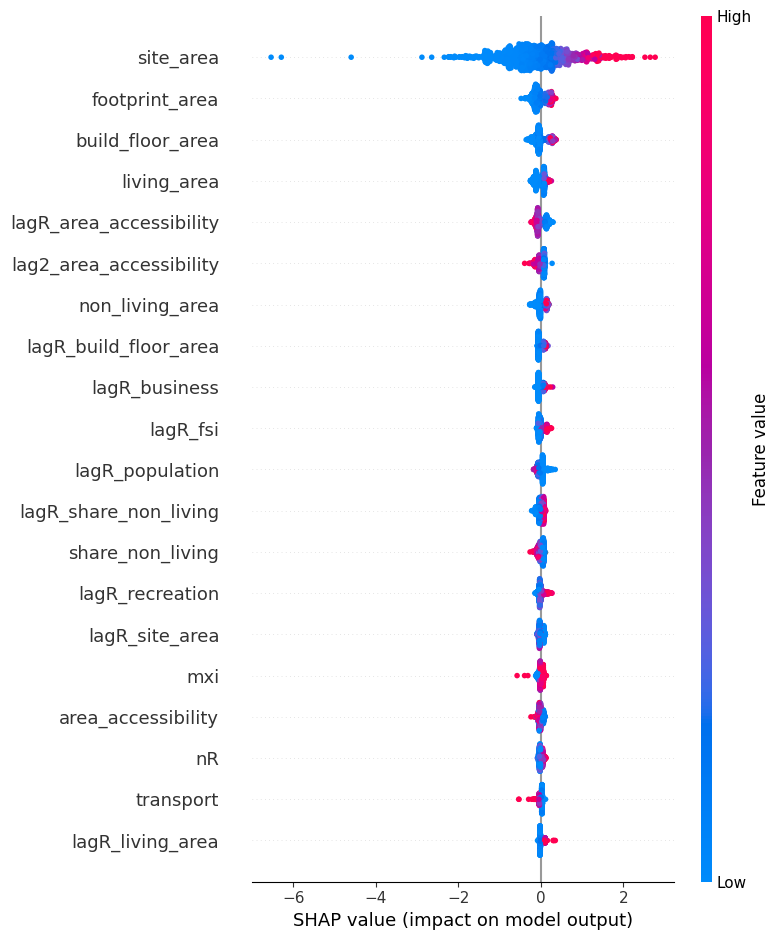

<Figure size 640x480 with 0 Axes>

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from catboost import CatBoostRegressor, Pool
import shap, matplotlib.pyplot as plt
from libpysal.weights import Queen, higher_order, DistanceBand, lag_spatial

# --- 0. Исходные данные ---

feature_cols = ['land_use', 'share',
       'footprint_area', 'build_floor_area', 'living_area', 'non_living_area',
       'population', 'site_area', 'fsi', 'gsi', 'mxi', 'l', 'osr',
       'share_living', 'share_non_living', 'morphotype', 'area_accessibility', 'residential', 'business', 'recreation', 'industrial',
       'transport', 'special', 'agriculture']

cat_feats     = ['land_use','morphotype']
numeric_feats = [c for c in feature_cols if c not in cat_feats]
# --- 1. Матрицы соседства ---
# 1) Сырые (бинарные) матрицы
w1 = Queen.from_dataframe(blocks)      # w1.weights — все 1
w2 = higher_order(w1, k=2)             # второй уровень соседей

# 2) Радиальный тоже сразу строим
R  = 1000
wR = DistanceBand.from_dataframe(
    blocks, threshold=R, binary=True, silence_warnings=True
)

# 3) Теперь нормализуем строки
w1.transform = 'r'
w2.transform = 'r'
wR.transform = 'r'

# --- 2. Генерация лаг-фичей трёх типов ---
lag_cols = []
for feat in numeric_feats:
    vec = blocks[feat].fillna(blocks[feat].mean())

    # лаг-среднее первого порядка
    blocks[f'lag1_{feat}'] = lag_spatial(w1, vec)
    lag_cols.append(f'lag1_{feat}')

    # лаг-среднее второго порядка
    blocks[f'lag2_{feat}'] = lag_spatial(w2, vec)
    lag_cols.append(f'lag2_{feat}')

    # лаг-среднее в радиусе R
    blocks[f'lagR_{feat}'] = lag_spatial(wR, vec)
    lag_cols.append(f'lagR_{feat}')

# (опционально) число соседей каждого вида
blocks['n1'] = pd.Series({i: len(nb) for i,nb in w1.neighbors.items()})
blocks['n2'] = pd.Series({i: len(nb) for i,nb in w2.neighbors.items()})
blocks['nR'] = pd.Series({i: len(nb) for i,nb in wR.neighbors.items()})
lag_cols += ['n1','n2','nR']

# --- 3. Собираем финальный список фичей и split ---
all_feats = feature_cols + lag_cols
X = blocks[all_feats]
y = blocks['log_total_price']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# --- 5. Предобработка категорий ---
cat_features = ['land_use', 'morphotype']
for df in (X_train, X_test):
    df['land_use'] = df['land_use'].fillna('missing')\
                                 .astype(str).astype('category')
    df['morphotype'] = df['morphotype'].fillna('missing')\
                                .astype(str).astype('category')

cat_feature_indices = [X_train.columns.get_loc(c) for c in cat_features]

# --- 6. Pool для CatBoost ---
train_pool = Pool(data=X_train, label=y_train, cat_features=cat_feature_indices)
test_pool  = Pool(data=X_test,  label=y_test,  cat_features=cat_feature_indices)

# --- 7. Обучение модели ---
model = CatBoostRegressor(
    iterations=8000,
    learning_rate=0.05,
    depth=5,
    eval_metric='RMSE',
    random_seed=42,
    verbose=100
)
model.fit(train_pool, eval_set=test_pool, early_stopping_rounds=100)

# --- 8. Оценка на тесте ---
y_pred = model.predict(X_test)
r2   = r2_score(y_test, y_pred)
mae  = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"R²   = {r2:.4f}")
print(f"MAE  = {mae:.4f}")
print(f"RMSE = {rmse:.4f}")

# --- 9. SHAP-анализ ---
explainer   = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# 9.1: глобальная важность (bar plot)
shap.summary_plot(shap_values, X_test, plot_type="bar")
plt.tight_layout()
plt.show()

# 9.2: Beeswarm-plot
shap.summary_plot(shap_values, X_test)
plt.tight_layout()
plt.show()


In [ ]:
# # предположим, что у вас есть переменная target_id с нужным значением id
# target_id = 3418

# # список нужных атрибутов
# cols = [
#     'land_use', 'share', 'footprint_area', 'build_floor_area',
#     'living_area', 'non_living_area', 'population', 'site_area',
#     'fsi', 'gsi', 'mxi', 'l', 'osr',
#     'share_living', 'share_non_living',
#     'morphotype', 'area_accessibility','geometry'
# ]
# row_gdf = blocks.loc[blocks['id'] == target_id, cols]
# row_gdf

Δ цены в процентах (после − до):
 • 33 (target): 18.586 → 19.749 (Δ +1.163 log, +219.8%)
 • 32 (1st-order): 18.476 → 18.418 (Δ -0.058 log, -5.6%)
 • 226 (1st-order): 18.820 → 18.875 (Δ +0.055 log, +5.7%)
 • 228 (1st-order): 19.210 → 19.197 (Δ -0.013 log, -1.2%)
 • 703 (1st-order): 17.954 → 18.031 (Δ +0.077 log, +8.1%)
 • 704 (1st-order): 18.456 → 18.583 (Δ +0.128 log, +13.6%)
 • 2728 (1st-order): 19.151 → 19.240 (Δ +0.089 log, +9.3%)
 • 2729 (1st-order): 18.585 → 18.513 (Δ -0.073 log, -7.0%)
 • 2730 (1st-order): 18.280 → 18.363 (Δ +0.083 log, +8.7%)
 • 186 (2nd-order): 19.044 → 18.985 (Δ -0.059 log, -5.7%)
 • 187 (2nd-order): 20.060 → 19.953 (Δ -0.107 log, -10.1%)
 • 225 (2nd-order): 18.691 → 18.693 (Δ +0.002 log, +0.2%)
 • 227 (2nd-order): 19.294 → 19.419 (Δ +0.124 log, +13.3%)
 • 230 (2nd-order): 19.279 → 19.418 (Δ +0.139 log, +15.0%)
 • 231 (2nd-order): 18.222 → 18.503 (Δ +0.280 log, +32.4%)
 • 232 (2nd-order): 18.456 → 18.768 (Δ +0.312 log, +36.7%)
 • 237 (2nd-order): 18.167 → 18.2

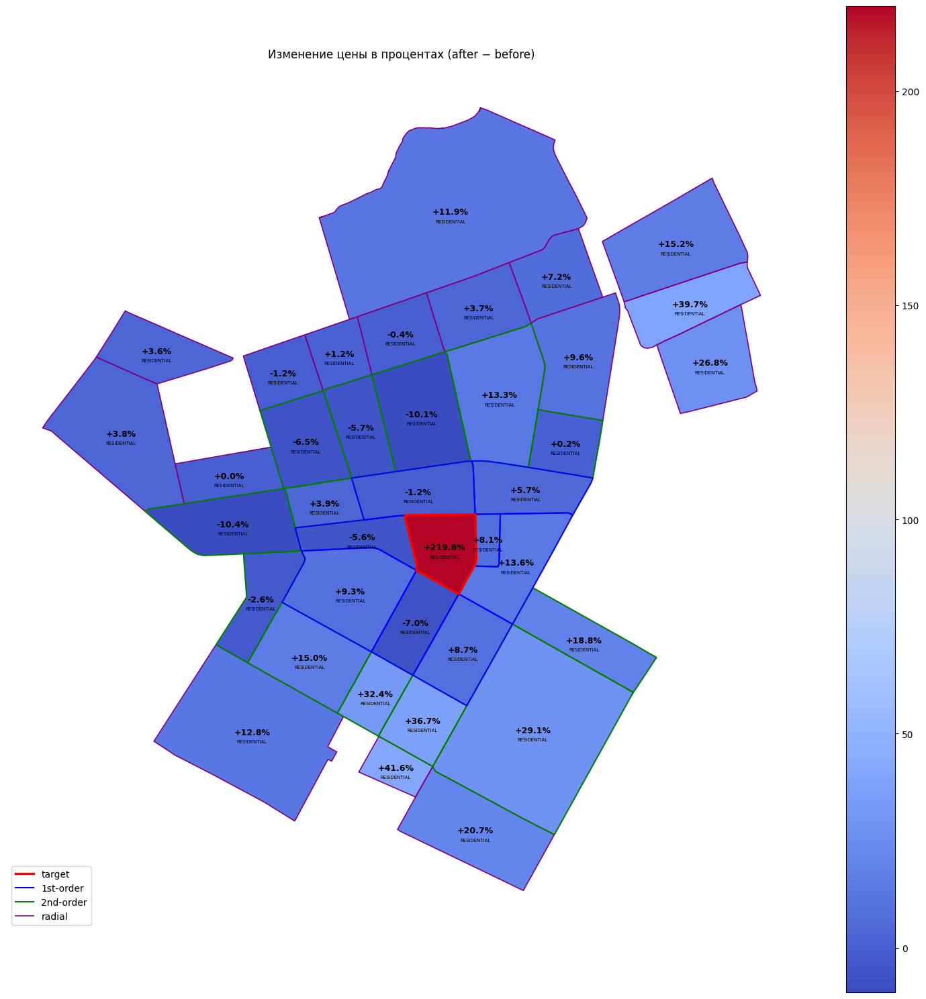

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from libpysal.weights import lag_spatial
from matplotlib.lines import Line2D
from matplotlib.transforms import offset_copy

def plot_scenario_with_types_highlight_target(
    blocks, w1, w2, wR, model,
    orig_feats, numeric_feats,
    target_idx, changes
):
    """
    Визуализация Δ log_total_price для target и соседей,
    с разметкой по типу соседства и явным выделением target.
    Сравниваем предсказания ДО и ПОСЛЕ «what-if», выводим изменение в процентах.
    """
    # 0) Подготовка индексов соседей
    ids1 = sorted(w1.neighbors[target_idx])
    ids2 = sorted(set(w2.neighbors[target_idx]) - set(ids1))
    idsR = sorted(set(wR.neighbors[target_idx]) - set(ids1) - set(ids2))
    idxs = [target_idx] + ids1 + ids2 + idsR

    # 1) Базовые данные и лаги
    blocks_base = blocks.copy()
    lag_cols = []
    gm = blocks_base[numeric_feats].mean()
    for feat in numeric_feats:
        vec = blocks_base[feat].fillna(gm[feat])
        for prefix, w in (('lag1', w1), ('lag2', w2), ('lagR', wR)):
            col = f'{prefix}_{feat}'
            blocks_base[col] = lag_spatial(w, vec)
            lag_cols.append(col)
    blocks_base['n1'] = pd.Series({i: len(nb) for i, nb in w1.neighbors.items()})
    blocks_base['n2'] = pd.Series({i: len(nb) for i, nb in w2.neighbors.items()})
    blocks_base['nR'] = pd.Series({i: len(nb) for i, nb in wR.neighbors.items()})
    lag_cols += ['n1', 'n2', 'nR']

    all_feats = orig_feats + lag_cols

    X_before = blocks_base.loc[idxs, all_feats].copy()
    X_before['land_use'] = X_before['land_use'].fillna('missing').astype(str).astype('category')
    X_before['morphotype'] = X_before['morphotype'].fillna(False).astype('bool').astype('category')
    preds_before = model.predict(X_before)

    # 2) Применяем изменения
    blocks_scn = blocks_base.copy()
    for feat, newval in changes.items():
        blocks_scn.at[target_idx, feat] = newval

    for feat in numeric_feats:
        vec = blocks_scn[feat].fillna(gm[feat])
        for prefix, w in (('lag1', w1), ('lag2', w2), ('lagR', wR)):
            col = f'{prefix}_{feat}'
            blocks_scn[col] = lag_spatial(w, vec)

    X_after = blocks_scn.loc[idxs, all_feats].copy()
    X_after['land_use'] = X_after['land_use'].fillna('missing').astype(str).astype('category')
    X_after['morphotype'] = X_after['morphotype'].fillna(False).astype('bool').astype('category')
    preds_after = model.predict(X_after)

    # 3) GeoDataFrame с расчетами
    gdf = blocks.loc[idxs].copy()
    gdf['pred_before'] = preds_before
    gdf['pred_after'] = preds_after
    gdf['log_diff'] = gdf['pred_after'] - gdf['pred_before']
    gdf['pct_change'] = (np.exp(gdf['log_diff']) - 1) * 100

    # 4) Текстовый отчет
    def ntype(i):
        if i == target_idx: return 'target'
        if i in ids1: return '1st-order'
        if i in ids2: return '2nd-order'
        return 'radial'

    print("Δ цены в процентах (после − до):")
    for i, r in gdf.iterrows():
        print(
            f" • {i} ({ntype(i)}): "
            f"{r['pred_before']:.3f} → {r['pred_after']:.3f} "
            f"(Δ {r['log_diff']:+.3f} log, {r['pct_change']:+.1f}%)"
        )

    # 5) Визуализация
    fig, ax = plt.subplots(figsize=(15, 15))
    gdf.plot(
        ax=ax, column='pct_change', cmap='coolwarm', legend=True,
        edgecolor='none', zorder=1
    )
    for i in idsR:
        gdf.loc[[i]].boundary.plot(ax=ax, color='purple', linewidth=1.2, zorder=2)
    for i in ids2:
        gdf.loc[[i]].boundary.plot(ax=ax, color='green', linewidth=1.5, zorder=3)
    for i in ids1:
        gdf.loc[[i]].boundary.plot(ax=ax, color='blue', linewidth=1.5, zorder=4)
    gdf.loc[[target_idx]].plot(ax=ax, facecolor='none', edgecolor='red', linewidth=2.5, zorder=5)

    ax.axis('off')
    ax.set_title('Изменение цены в процентах (after − before)', pad=12)

    legend_elems = [
        Line2D([0], [0], color='red', lw=2.5, label='target'),
        Line2D([0], [0], color='blue', lw=1.5, label='1st-order'),
        Line2D([0], [0], color='green', lw=1.5, label='2nd-order'),
        Line2D([0], [0], color='purple', lw=1.2, label='radial'),
    ]
    ax.legend(handles=legend_elems, loc='lower left')

    # 6) Подписи проценты и land_use
    for i, r in gdf.iterrows():
        x, y = r.geometry.centroid.coords[0]
        # % изменение
        ax.text(
            x, y, f"{r['pct_change']:+.1f}%",
            ha='center', va='center',
            fontsize=9, fontweight='bold', zorder=6
        )
        # land_use под %
        ax.text(
            x, y,
            str(r['land_use']),
            ha='center', va='center',
            fontsize=5, color='black', zorder=6,
            transform=offset_copy(ax.transData, fig=fig, y=-10, units='points')
        )

    plt.tight_layout()
    plt.show()


plot_scenario_with_types_highlight_target(
    blocks=blocks,
    w1=w1, w2=w2, wR=wR,
    model=model,
    orig_feats=feature_cols,
    numeric_feats=numeric_feats,
    target_idx=33,
    changes={
        'footprint_area': 49039.24,
        'build_floor_area': 230279.19,
        'living_area': 155896.85,
        'population': 5168,
        'fsi': 2.80,
        'mxi': 0.68,
        'l': 6.93,
        'osr': 0.21,
        'share_living': 4.69
    }
)


# CatBoost 2 

/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
/Users/mvin/Code/blocksnet/.venv/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `fram

0:	learn: 2.1631424	test: 2.1735908	best: 2.1735908 (0)	total: 67.1ms	remaining: 8m 56s
100:	learn: 1.1136745	test: 1.1451232	best: 1.1451232 (100)	total: 453ms	remaining: 35.4s
200:	learn: 1.0091309	test: 1.0940734	best: 1.0940734 (200)	total: 842ms	remaining: 32.7s
300:	learn: 0.9347426	test: 1.0678287	best: 1.0678287 (300)	total: 1.25s	remaining: 31.8s
400:	learn: 0.8815993	test: 1.0578656	best: 1.0578605 (386)	total: 1.61s	remaining: 30.6s
500:	learn: 0.8368941	test: 1.0539382	best: 1.0538557 (456)	total: 2.01s	remaining: 30.1s
600:	learn: 0.7980747	test: 1.0495234	best: 1.0492323 (596)	total: 2.38s	remaining: 29.4s
700:	learn: 0.7659347	test: 1.0456864	best: 1.0456864 (700)	total: 2.75s	remaining: 28.7s
800:	learn: 0.7345081	test: 1.0444499	best: 1.0442930 (792)	total: 3.12s	remaining: 28s
900:	learn: 0.7049206	test: 1.0447489	best: 1.0442623 (809)	total: 3.49s	remaining: 27.5s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 1.04426227
bestIteration = 809

Shrin

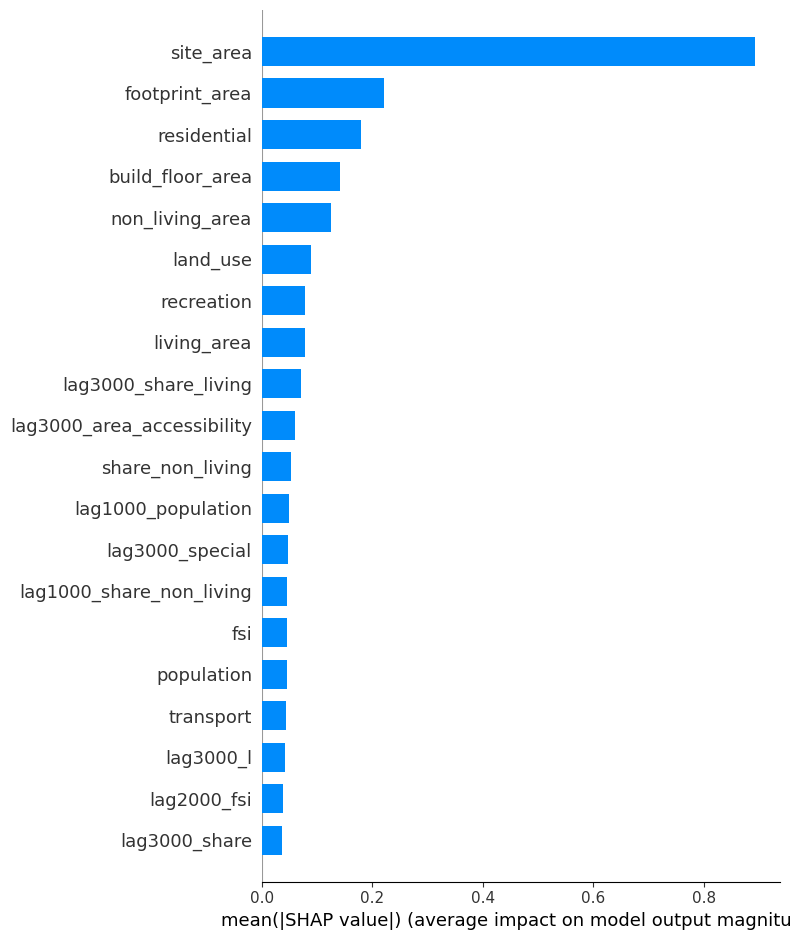

<Figure size 640x480 with 0 Axes>

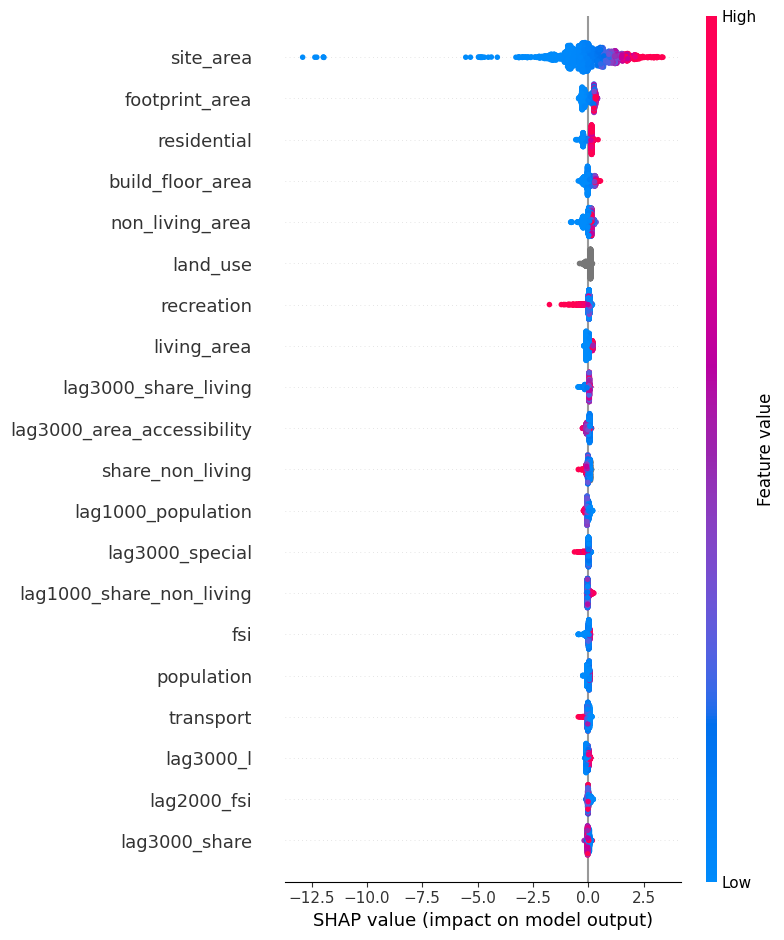

<Figure size 640x480 with 0 Axes>

In [41]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from catboost import CatBoostRegressor, Pool
import shap
import matplotlib.pyplot as plt
from libpysal.weights import DistanceBand, lag_spatial

# --- 0. Исходные данные ---
feature_cols = [
    'land_use', 'share',
    'footprint_area', 'build_floor_area', 'living_area', 'non_living_area',
    'population', 'site_area', 'fsi', 'gsi', 'mxi', 'l', 'osr',
    'share_living', 'share_non_living', 'morphotype', 'area_accessibility',
    'residential', 'business', 'recreation', 'industrial',
    'transport', 'special', 'agriculture'
]
cat_feats = ['land_use', 'morphotype']
numeric_feats = [c for c in feature_cols if c not in cat_feats]

# --- 1. Радиальные матрицы соседства ---
radius_list = [100, 500, 1000, 2000, 3000]
w_radii = {}
for r in radius_list:
    w = DistanceBand.from_dataframe(
        blocks, threshold=r, binary=True, silence_warnings=True
    )
    w.transform = 'r'  # нормализация строк
    w_radii[r] = w

# --- 2. Генерация лаг-фичей по радиусам ---
lag_cols = []
for feat in numeric_feats:
    vec = blocks[feat].fillna(blocks[feat].mean())
    for r in radius_list:
        col_name = f'lag{r}_{feat}'
        blocks[col_name] = lag_spatial(w_radii[r], vec)
        lag_cols.append(col_name)

# (опционально) число соседей по каждому радиусу
for r in radius_list:
    n_col = f'n_neighbors_{r}'
    blocks[n_col] = pd.Series({i: len(nb) for i, nb in w_radii[r].neighbors.items()})
    lag_cols.append(n_col)

# --- 3. Финальный список фичей и train/test split ---
all_feats = feature_cols + lag_cols
X = blocks[all_feats]
y = blocks['log_total_price']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# --- 4. Предобработка категориальных фичей ---
cat_features = ['land_use', 'morphotype']
for df in (X_train, X_test):
    df['land_use'] = df['land_use'].fillna('missing').astype(str).astype('category')
    df['morphotype'] = df['morphotype'].fillna('missing').astype(str).astype('category')

cat_feature_indices = [X_train.columns.get_loc(c) for c in cat_features]

# --- 5. Pool для CatBoost ---
train_pool = Pool(data=X_train, label=y_train, cat_features=cat_feature_indices)
test_pool = Pool(data=X_test, label=y_test, cat_features=cat_feature_indices)

# --- 6. Обучение модели ---
model = CatBoostRegressor(
    iterations=8000,
    learning_rate=0.05,
    depth=5,
    eval_metric='RMSE',
    random_seed=42,
    verbose=100
)
model.fit(train_pool, eval_set=test_pool, early_stopping_rounds=100)

# --- 7. Оценка на тесте ---
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"R²   = {r2:.4f}")
print(f"MAE  = {mae:.4f}")
print(f"RMSE = {rmse:.4f}")

# --- 8. SHAP-анализ ---
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# 8.1 Глобальная важность
shap.summary_plot(shap_values, X_test, plot_type="bar")
plt.tight_layout()
plt.show()

# 8.2 Beeswarm
shap.summary_plot(shap_values, X_test)
plt.tight_layout()
plt.show()


In [49]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from libpysal.weights import lag_spatial
from matplotlib.lines import Line2D
from matplotlib.transforms import offset_copy

def plot_scenario_with_radii(
    blocks, w_radii, model,
    orig_feats, numeric_feats,
    target_idx, changes
):
    """
    Визуализация Δ log_total_price для target и соседей по радиусам,
    с разметкой и выводом изменения в процентах.
    """
    radius_list = sorted(w_radii.keys())  # например [100,500,1000,2000,3000]

    # 0) Подготовка индексов соседей по каждому радиусу
    radius_ids = {}
    prev_ids = set()
    for r in radius_list:
        ids = set(w_radii[r].neighbors.get(target_idx, []))
        # исключаем всё, что уже попало в меньшие радиусы
        ids = ids - prev_ids
        radius_ids[r] = sorted(ids)
        prev_ids |= ids

    # Составляем итоговый список всех индексов
    idxs = [target_idx] + [i for r in radius_list for i in radius_ids[r]]

    # 1) Базовые данные и лаги
    blocks_base = blocks.copy()
    lag_cols = []
    gm = blocks_base[numeric_feats].mean()

    for feat in numeric_feats:
        vec = blocks_base[feat].fillna(gm[feat])
        for r in radius_list:
            col = f'lag{r}_{feat}'
            blocks_base[col] = lag_spatial(w_radii[r], vec)
            lag_cols.append(col)

    # Число соседей по каждому радиусу
    for r in radius_list:
        ncol = f'n_neighbors_{r}'
        blocks_base[ncol] = pd.Series({i: len(nb) for i, nb in w_radii[r].neighbors.items()})
        lag_cols.append(ncol)

    all_feats = orig_feats + lag_cols

    # 2) Признаки до изменений
    X_before = blocks_base.loc[idxs, all_feats].copy()
    X_before['land_use'] = X_before['land_use'].fillna('missing').astype(str).astype('category')
    X_before['morphotype'] = X_before['morphotype'].fillna(False).astype('bool').astype('category')
    preds_before = model.predict(X_before)

    # 3) Применяем изменения
    blocks_scn = blocks_base.copy()
    for feat, newval in changes.items():
        blocks_scn.at[target_idx, feat] = newval

    for feat in numeric_feats:
        vec = blocks_scn[feat].fillna(gm[feat])
        for r in radius_list:
            col = f'lag{r}_{feat}'
            blocks_scn[col] = lag_spatial(w_radii[r], vec)

    X_after = blocks_scn.loc[idxs, all_feats].copy()
    X_after['land_use'] = X_after['land_use'].fillna('missing').astype(str).astype('category')
    X_after['morphotype'] = X_after['morphotype'].fillna(False).astype('bool').astype('category')
    preds_after = model.predict(X_after)

    # 4) GeoDataFrame с расчетами
    gdf = blocks.loc[idxs].copy()
    gdf['pred_before'] = preds_before
    gdf['pred_after'] = preds_after
    gdf['log_diff'] = gdf['pred_after'] - gdf['pred_before']
    gdf['pct_change'] = (np.exp(gdf['log_diff']) - 1) * 100

    # 5) Текстовый отчет
    def ntype(i):
        if i == target_idx:
            return 'target'
        for r in radius_list:
            if i in radius_ids[r]:
                return f'radius_{r}m'
        return 'other'

    print("Δ цены в процентах (после − до):")
    for i, r in gdf.iterrows():
        print(
            f" • {i} ({ntype(i)}): "
            f"{r['pred_before']:.3f} → {r['pred_after']:.3f} "
            f"(Δ {r['log_diff']:+.3f} log, {r['pct_change']:+.1f}%)"
        )

    # 6) Сводная статистика по радиусам
    stats = []
    for r in radius_list:
        ids = radius_ids[r]
        if ids:
            mean_pct = gdf.loc[ids, 'pct_change'].mean()
            std_pct = gdf.loc[ids, 'pct_change'].std()
            stats.append((r, mean_pct, std_pct, len(ids)))
        else:
            stats.append((r, np.nan, np.nan, 0))

    print("\nСреднее изменение цены по радиусам:")
    for r, m, s, n in stats:
        print(f" • Радиус {r}м: среднее {m:+.1f}%, std {s:.1f}, участков {n}")

    # 7) Визуализация
    fig, ax = plt.subplots(figsize=(25, 25))
    gdf.plot(
        ax=ax, column='pct_change', cmap='coolwarm', legend=True,
        edgecolor='none', zorder=1
    )

    colors = ['blue', 'green', 'orange', 'purple', 'brown']
    for color, r in zip(colors, radius_list):
        ids = radius_ids[r]
        if ids:
            gdf.loc[ids].boundary.plot(ax=ax, color=color, linewidth=1.5, zorder=3)

    # Целевой участок
    gdf.loc[[target_idx]].plot(ax=ax, facecolor='none', edgecolor='red', linewidth=2.5, zorder=4)

    ax.axis('off')
    ax.set_title('Изменение цены в процентах (after − before)', pad=12)

    legend_elems = [
        Line2D([0], [0], color='red', lw=2.5, label='target'),
    ] + [
        Line2D([0], [0], color=c, lw=1.5, label=f'radius {r}m') for c, r in zip(colors, radius_list)
    ]
    ax.legend(handles=legend_elems, loc='lower left')

    # 8) Подписи
    for i, r in gdf.iterrows():
        x, y = r.geometry.centroid.coords[0]
        ax.text(
            x, y, f"{r['pct_change']:+.1f}%",
            ha='center', va='center',
            fontsize=9, fontweight='bold', zorder=6
        )
        ax.text(
            x, y,
            str(r['land_use']),
            ha='center', va='center',
            fontsize=5, color='black', zorder=6,
            transform=offset_copy(ax.transData, fig=fig, y=-10, units='points')
        )

    plt.tight_layout()
    plt.show()


Δ цены в процентах (после − до):
 • 4342 (target): 20.979 → 21.174 (Δ +0.196 log, +21.6%)
 • 312 (radius_500m): 20.031 → 20.017 (Δ -0.014 log, -1.4%)
 • 4336 (radius_500m): 20.867 → 20.867 (Δ -0.000 log, -0.0%)
 • 5084 (radius_500m): 18.897 → 18.869 (Δ -0.028 log, -2.8%)
 • 5085 (radius_500m): 19.946 → 19.942 (Δ -0.004 log, -0.4%)
 • 5086 (radius_500m): 20.930 → 20.930 (Δ +0.000 log, +0.0%)
 • 5087 (radius_500m): 21.076 → 21.101 (Δ +0.025 log, +2.5%)
 • 7788 (radius_500m): 20.074 → 20.052 (Δ -0.023 log, -2.3%)
 • 7789 (radius_500m): 19.324 → 19.321 (Δ -0.003 log, -0.3%)
 • 8749 (radius_500m): 18.129 → 18.129 (Δ +0.000 log, +0.0%)
 • 8750 (radius_500m): 19.991 → 19.981 (Δ -0.010 log, -1.0%)
 • 3224 (radius_1000m): 18.305 → 18.305 (Δ +0.000 log, +0.0%)
 • 3630 (radius_1000m): 19.975 → 19.973 (Δ -0.001 log, -0.1%)
 • 4301 (radius_1000m): 19.324 → 19.305 (Δ -0.019 log, -1.9%)
 • 4302 (radius_1000m): 18.673 → 18.676 (Δ +0.002 log, +0.2%)
 • 4303 (radius_1000m): 19.112 → 19.113 (Δ +0.001 log

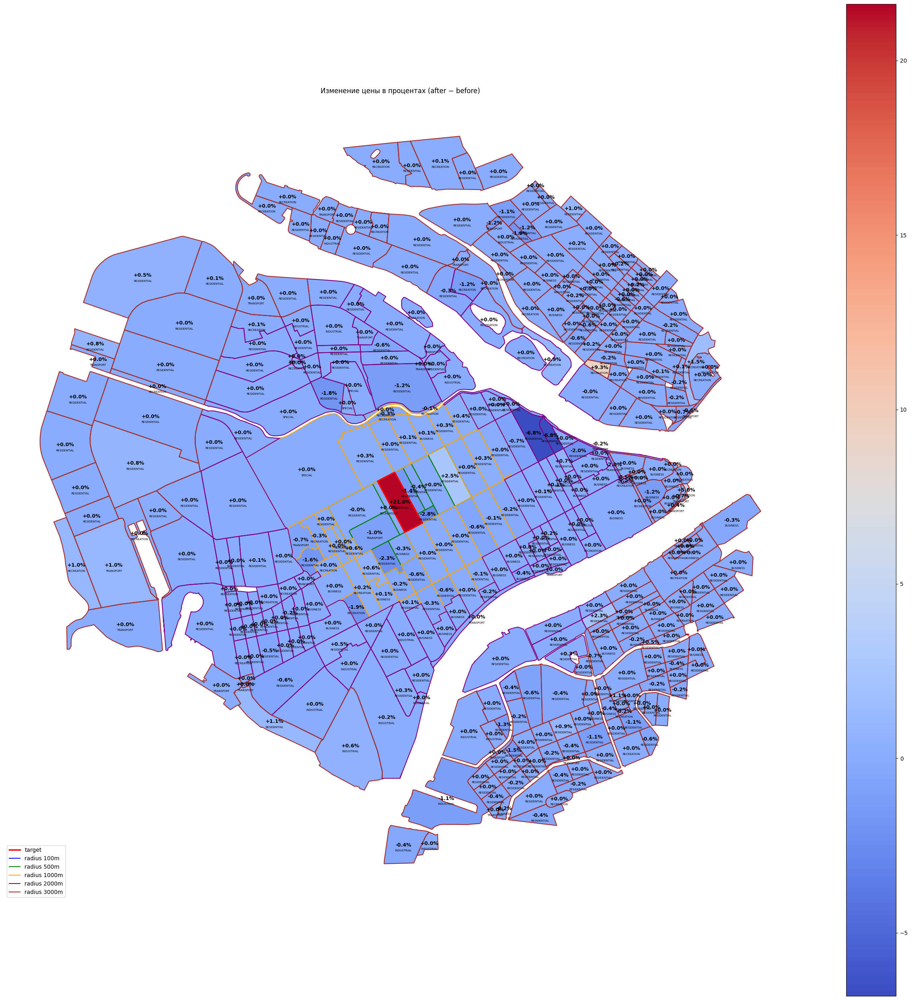

In [50]:
plot_scenario_with_radii(
    blocks=blocks,
    w_radii=w_radii,          # это словарь {100: w100, 500: w500, ...}
    model=model,
    orig_feats=feature_cols,
    numeric_feats=numeric_feats,
    target_idx=4342,
    changes={
        'footprint_area': 49039.24,
        'build_floor_area': 230279.19,
        'living_area': 155896.85,
        'population': 5168,
        'fsi': 2.80,
        'mxi': 0.68,
        'l': 6.93,
        'osr': 0.21,
        'share_living': 4.69
    }
)
